## In this file, we will focus ourselves in the choice of which model we want to keep
## The creation of the dcgan and its training will be done in the file dcgan.ipynb

In [49]:
import ipynb.fs.full.dcgan as dcgan
import random
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import numpy as np
from IPython.display import HTML

import warnings
warnings.filterwarnings('ignore')

In [50]:
path = 'data/'
enum = ['all', 'bug', 'dark', 'dragon', 'electric', 'fairy', 'fighting', 'fire', 'flying', 'ghost', 'grass', 'ground', 'ice', 'normal', 'poison', 'psychic', 'rock', 'steel', 'water']

In [51]:
rnd = random.Random()
rd = rnd.randint(0, len(enum))
random_type = enum[rd]
print("Type(s) chosen for creating new Pokemon : " + random_type)

Type(s) chosen for creating new Pokemon : dragon


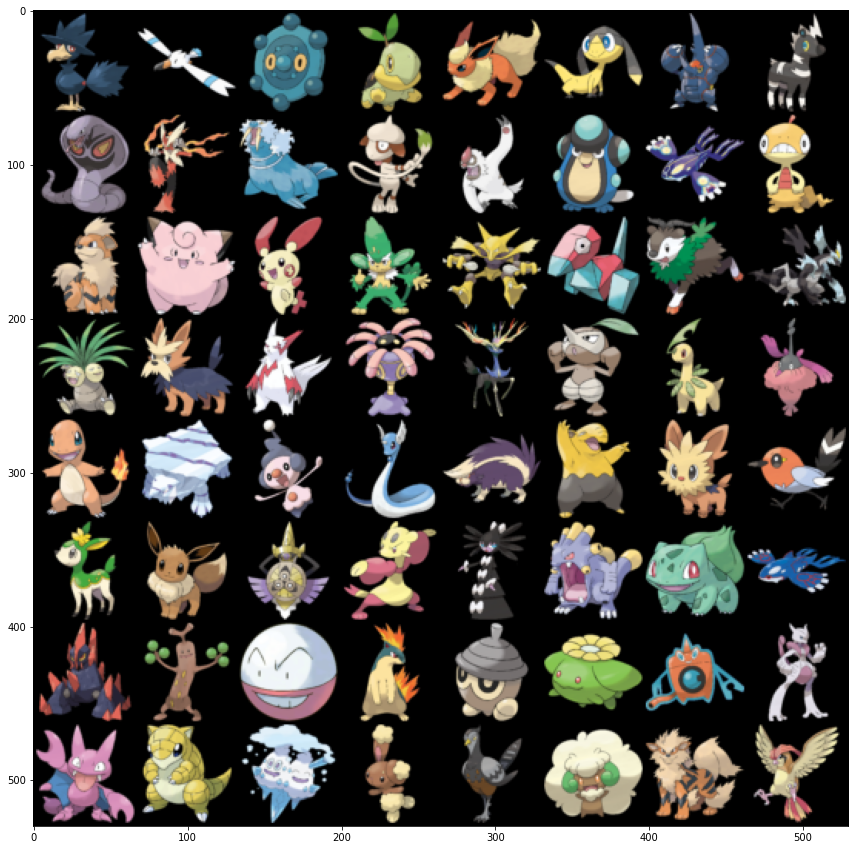

In [52]:
trainloader = dcgan.create_trainloader(path + 'all', 64, 64)
dcgan.show_some_pokemon(trainloader, 64, 8)

In [53]:
generator = dcgan.create_generator()
discriminator = dcgan.create_discriminator()

In [54]:
res_gen, res_dis, images, losses = dcgan.machine_learning(trainloader, generator, discriminator, epochs = 200)

Epoch: 1 / 50 	Discriminator Loss: 0.006608 	Generator Loss: 0.072910 	D(x): 0.912012 	D(G(z)): 11.722415
Epoch: 2 / 50 	Discriminator Loss: 0.001025 	Generator Loss: 0.048564 	D(x): 0.960546 	D(G(z)): 17.843716
Epoch: 3 / 50 	Discriminator Loss: 0.000648 	Generator Loss: 0.041362 	D(x): 0.960010 	D(G(z)): 80.458904
Epoch: 4 / 50 	Discriminator Loss: 0.002846 	Generator Loss: 0.049066 	D(x): 0.873172 	D(G(z)): 46.078195
Epoch: 5 / 50 	Discriminator Loss: 0.001138 	Generator Loss: 0.032414 	D(x): 0.918539 	D(G(z)): 109.054073
Epoch: 6 / 50 	Discriminator Loss: 0.000445 	Generator Loss: 0.019596 	D(x): 0.924590 	D(G(z)): 78.490044
Epoch: 7 / 50 	Discriminator Loss: 0.000525 	Generator Loss: 0.028528 	D(x): 0.917183 	D(G(z)): 103.922862
Epoch: 8 / 50 	Discriminator Loss: 0.000340 	Generator Loss: 0.024813 	D(x): 0.957291 	D(G(z)): 56.707707
Epoch: 9 / 50 	Discriminator Loss: 0.000131 	Generator Loss: 0.017743 	D(x): 0.972935 	D(G(z)): 58.716613
Epoch: 10 / 50 	Discriminator Loss: 0.000597

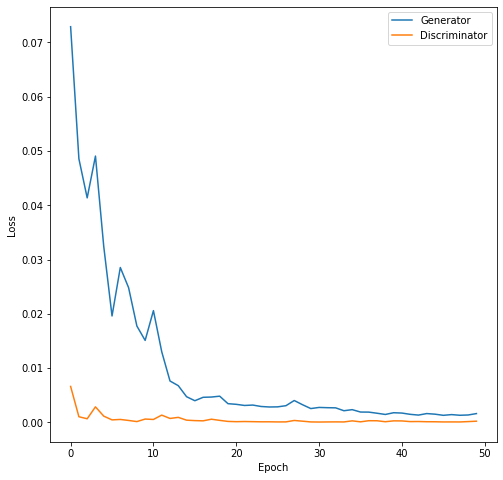

In [55]:
dcgan.show_losses(losses[0], losses[1])

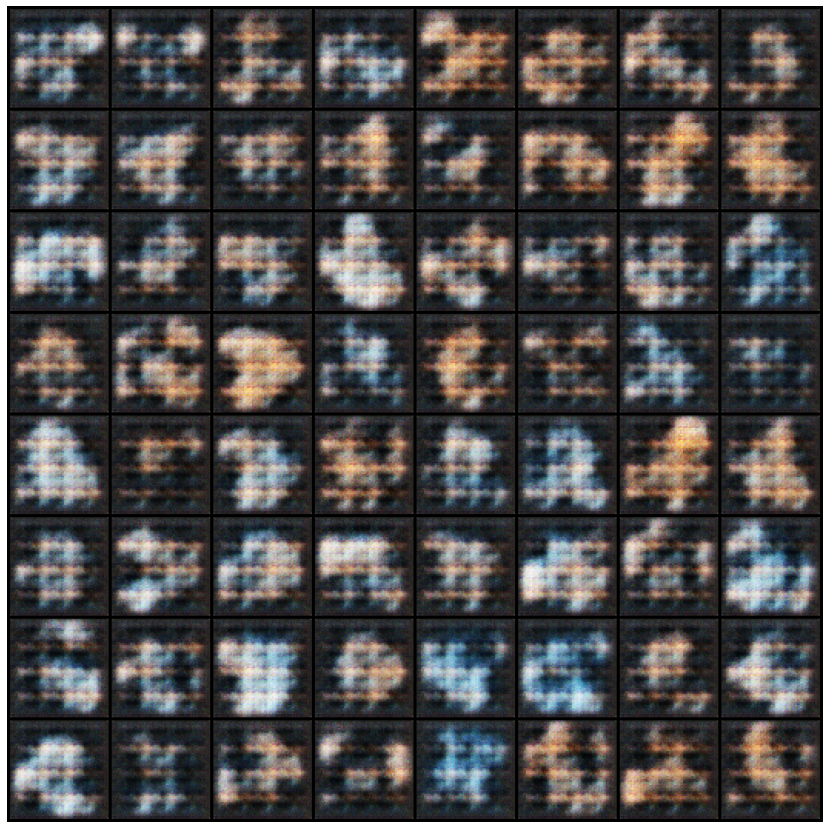

In [62]:
fig = plt.figure(figsize = (15, 15))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i, (1, 2, 0)), animated = True)] for i in images[::5]]
ani = animation.ArtistAnimation(fig, ims, interval=250, repeat_delay=250, blit=True)
HTML(ani.to_jshtml())